In [19]:
import numpy as np
import matplotlib.pyplot as plt
import pickle
from sklearn.metrics import confusion_matrix, classification_report, jaccard_score, precision_score
import yaml
import pandas as pd
pd.__version__

'1.0.3'

In [20]:
val = pickle.load(open('cluster_val.pkl','rb'))
y_val = pickle.load(open('cluster_y_val.pkl','rb'))
preds = pickle.load(open('FINAL-2/FINAL-2-preds.pkl','rb'))
test = pickle.load(open('../../data/processed/test.pkl','rb'))
y_test = pickle.load(open('../../data/processed/y_test.pkl','rb'))
test_preds = pickle.load(open('FINAL-2/FINAL-2-test-preds.pkl','rb'))
test.shape, test_preds.shape, y_test.shape

((175, 256, 256, 1), (175, 256, 256), (175, 256, 256, 1))

In [21]:
counts = np.unique(y_test, return_counts=True)[1]
counts/counts.sum()

array([0.9335417 , 0.01961426, 0.04684405])

In [22]:
counts = np.unique(test_preds, return_counts=True)[1]
counts/counts.sum()

array([0.95905439, 0.0019853 , 0.03896031])

In [26]:
print(jaccard_score(y_test.flatten(),test_preds.flatten(),average='macro'))
print(classification_report(y_test.flatten(),test_preds.flatten(),digits=3))

0.35861595503877025
              precision    recall  f1-score   support

           0      0.945     0.971     0.958  10706603
           1      0.159     0.016     0.029    224952
           2      0.274     0.228     0.249    537245

    accuracy                          0.917  11468800
   macro avg      0.459     0.405     0.412  11468800
weighted avg      0.898     0.917     0.906  11468800



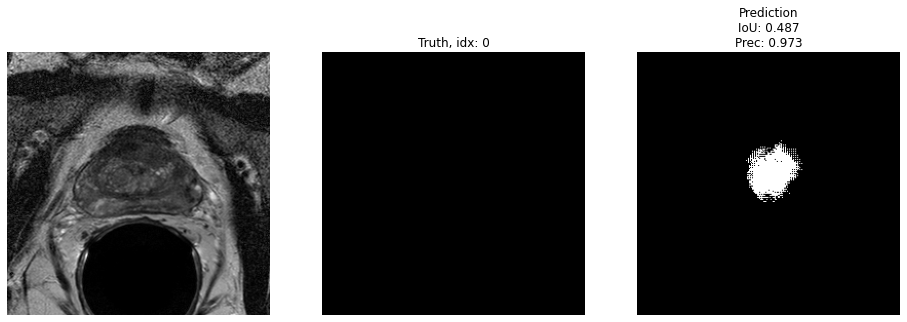

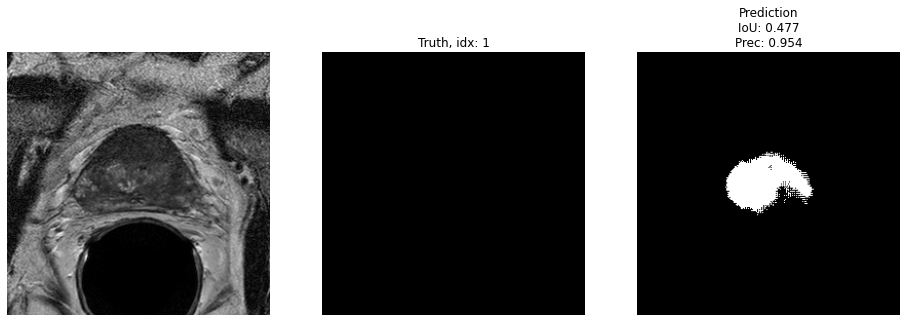

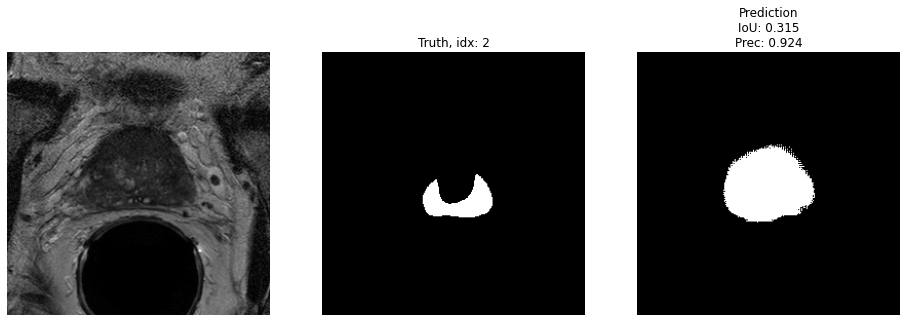

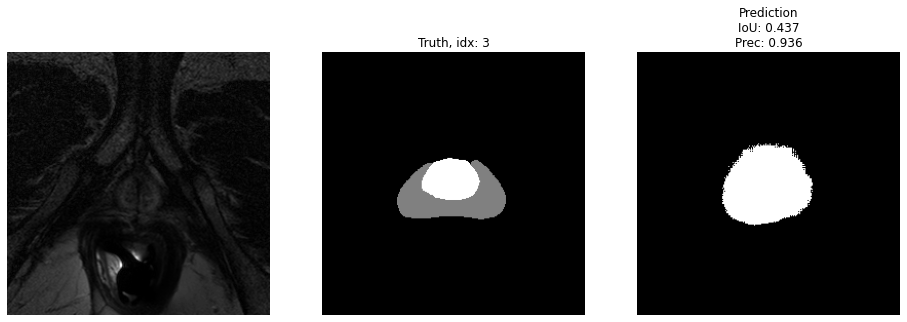

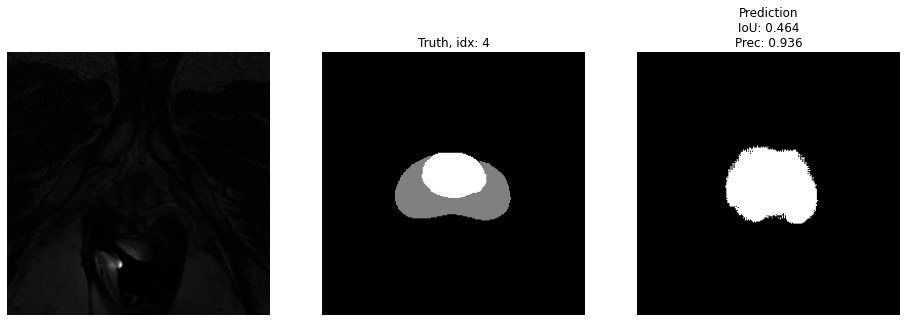

...

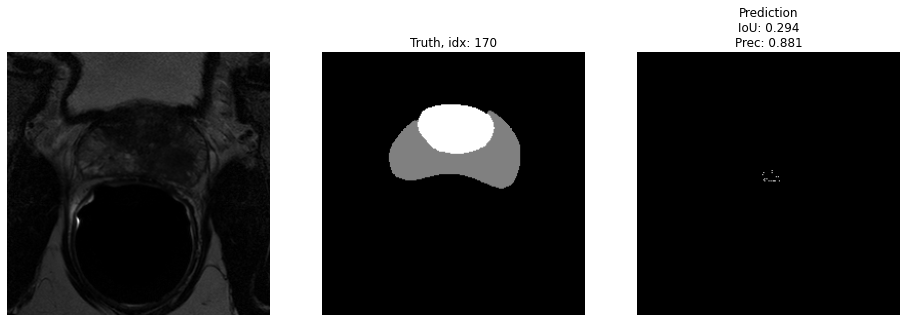

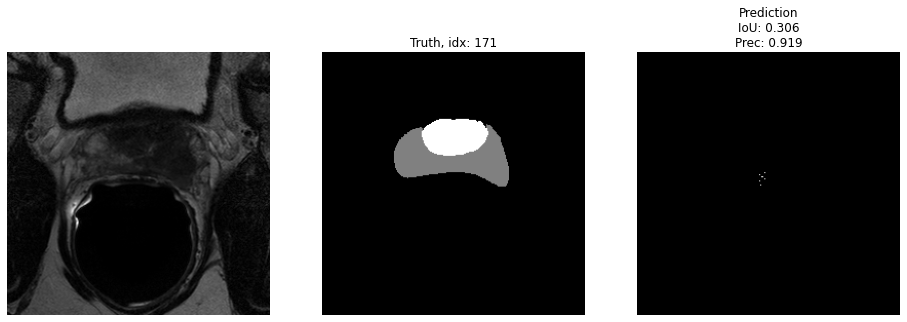

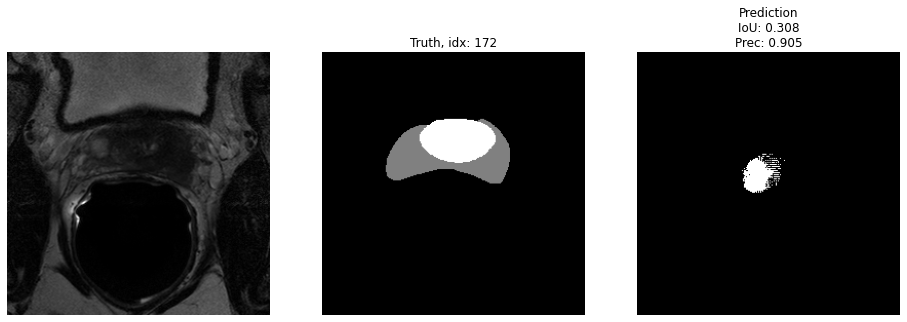

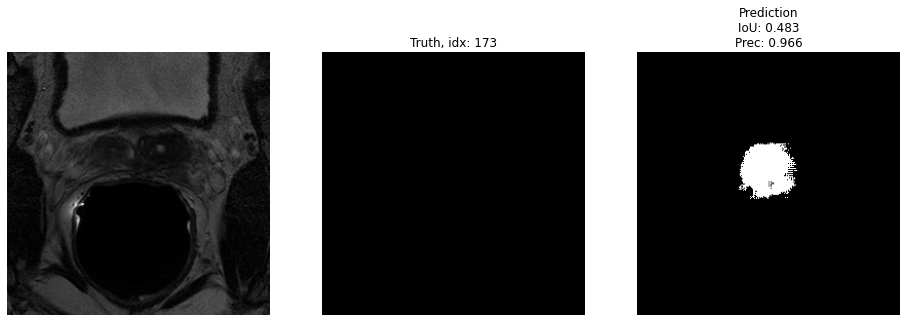

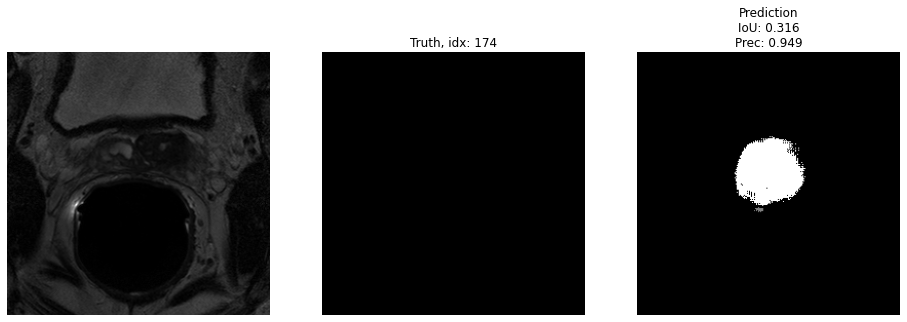

In [25]:
for i in range(175):
    idx=i
    plt.figure(figsize=(16,9))
    plt.subplot(1,3,1)
    plt.imshow(test[idx,:,:,0],cmap='gray')
    plt.axis('off')
    plt.subplot(1,3,2)
    plt.imshow(y_test[idx,:,:,0],cmap='gray')
    plt.axis('off')
    plt.title(f'Truth, idx: {i}')
    plt.subplot(1,3,3)
    plt.imshow(test_preds[idx,:,:],cmap='gray')
    plt.axis('off')
    plt.title(f"Prediction\nIoU: {jaccard_score(y_test[idx,:,:,0].flatten(),test_preds[idx,:,:].flatten(),average='macro') :.3f}\nPrec: {precision_score(y_test[idx,:,:,0].flatten(),test_preds[idx,:,:].flatten(),average='micro') :.3f}")
    plt.show()
    #plt.savefig(f'../visualizations/example-{idx}',dpi=100)

In [7]:
models = ['FOC-DEEP', 'FINAL', 'FINAL-2']
for m in models:
    print(m)
    path = "./"+m+"/eval.yaml"
    results = yaml.safe_load(open(path,'rb'))
    print(f"OP: {results['val-data']['accuracy'] :.3f}")
    print(f"PC: {results['val-data']['macro avg']['precision']:.3f}")
    print(f"Jaccard-score: {results['val-jaccard-score']:.3f}")
    print('\n')

FOC-DEEP
OP: 0.968
PC: 0.845
Jaccard-score: 0.655


FINAL
OP: 0.969
PC: 0.850
Jaccard-score: 0.646


FINAL-2
OP: 0.966
PC: 0.873
Jaccard-score: 0.602


